In [1]:
import base64
import glob
from io import BytesIO
import os
import re

from bokeh.embed import file_html
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
from bokeh.plotting import figure, show, output_notebook
from bokeh.resources import CDN

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
import umap

output_notebook()

Loading BokehJS ...

## Loading Data

The dataset used in this analysis was taken from [Kaggle](https://www.kaggle.com/alopez247/pokemon). For UMAP projections of data including categorical features, the `cluster` package in R was used for computation of Gower distance.

In [2]:
pokemon_df = pd.read_csv("../data/raw/pokemon/pokemon_alopez247.csv", index_col=0)
pokemon_dm_gower = pd.read_csv("../data/processed/pokemon_dm_gower.csv", sep=",", index_col=0)
pokemon_dm_gower_cat = pd.read_csv("../data/processed/pokemon_dm_gower_only_categorical.csv", sep=",", index_col=0)
pokemon_df = pokemon_df.reset_index(drop=True)
for col in pokemon_df.columns:
    if pokemon_df[col].dtype == 'bool':
        pokemon_df[col] = pokemon_df[col].astype(str)
pokemon_df.head()

,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,...,Color,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style
0,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,...,Green,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped
1,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,...,Green,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped
2,Venusaur,Grass,Poison,525,80,82,83,100,100,80,...,Green,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped
3,Charmander,Fire,NaN,309,39,52,43,60,50,65,...,Red,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed
4,Charmeleon,Fire,NaN,405,58,64,58,80,65,80,...,Red,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed


It occurred to me that, for Pokemon with only a single type, the clustering may not recognize the relationship with Pokemon who have the same type as Type 2. For example, Marowak as a primary Ground type would not be recognized as close in the composite "Type" dimension to Swampert, who is a Water/Ground type. The same problem applies to Egg Groups. To remedy this, for Pokemon with only one type/egg group, I filled in their secondary attribute with a copy of the first.

In [3]:
def fill_type2(row):
    if str(row["Type_2"]) == 'nan':
        return row["Type_1"]
    else:
        return row["Type_2"]
    
def fill_egg_group2(row):
    if str(row["Egg_Group_2"]) == 'nan':
        return row["Egg_Group_1"]
    else:
        return row["Egg_Group_2"]
    
pokemon_df["Type_2"] = pokemon_df.apply(fill_type2, 1)
pokemon_df["Egg_Group_2"] = pokemon_df.apply(fill_egg_group2, 1)
pokemon_df.head()

,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,...,Color,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style
0,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,...,Green,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped
1,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,...,Green,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped
2,Venusaur,Grass,Poison,525,80,82,83,100,100,80,...,Green,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped
3,Charmander,Fire,Fire,309,39,52,43,60,50,65,...,Red,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed
4,Charmeleon,Fire,Fire,405,58,64,58,80,65,80,...,Red,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed


In [4]:
pokemon_df.columns

Index(['Name', 'Type_1', 'Type_2', 'Total', 'HP', 'Attack', 'Defense',
       'Sp_Atk', 'Sp_Def', 'Speed', 'Generation', 'isLegendary', 'Color',
       'hasGender', 'Pr_Male', 'Egg_Group_1', 'Egg_Group_2',
       'hasMegaEvolution', 'Height_m', 'Weight_kg', 'Catch_Rate',
       'Body_Style'],
      dtype='object')

## Functions

In [5]:
def embeddable_image(data):
    """Get image to embed for bokeh plot"""
    # adapted from umap documentation
    # https://umap-learn.readthedocs.io/en/latest/basic_usage.html
    buffer = BytesIO()
    data.save(buffer, format='png')
    for_encoding = buffer.getvalue()
    return 'data:image/png;base64,' + base64.b64encode(for_encoding).decode()

In [6]:
def plot_bokeh(umap_results, title, name=None, location=None, **kwargs):
    plot_df = pd.DataFrame(umap_results)
    plot_df = plot_df.join(pokemon_df)
    plot_df.rename(columns={0:'x', 1:'y'}, inplace=True)

    datasource = ColumnDataSource(plot_df)

    plot_figure = figure(
        title=title,
        plot_width=600,
        plot_height=600,
        tools=('pan, wheel_zoom, reset')
    )

    plot_figure.add_tools(HoverTool(tooltips="""
    <div>
        <div>
            <img src='@img' style='float: left; margin: 5px 5px 5px 5px'/>
        </div>
        <div>
            <span style='font-size: 16px; color: #224499'>Pokemon:</span>
            <span style='font-size: 18px'>@Name</span>
        </div>
    </div>
    """))

    plot_figure.circle(
        'x',
        'y',
        source=datasource,
        **kwargs,
    )
    plot_figure.title.text_font_size = '14pt'
    show(plot_figure)

    if name is not None:
        save_to_html(plot_figure, name, location)
        
def save_to_html(plot, name, location):
    html = file_html(plot, CDN, name)
    with open(location, "w+") as f:
        f.write(html) 

In [7]:
all_egg_groups = set(pokemon_df["Egg_Group_1"]) & set(pokemon_df["Egg_Group_2"])
all_egg_groups = sorted(all_egg_groups)

def get_either_param(row, param1, param2, value):
    """Return whether Pokemon has value in param.
    
    Parameters:
    -----------
        row: single row from pd.DataFrame.iterrows()
        param1: first column to check
        param2: second column to check
        value: value in column to associate
    
    Returns:
    --------
        value/other: if value is present in row, return it
            else, return "other"
    
    Usage:
    ------
        df["color"] = df.apply(
            get_either_param, 
            1, 
            param1="Egg_Group_1",
            param2="Egg_Group_2",
            value="Amorphous",
        )
    
    """
    if row[param1] == value or row[param2] == value:
        return value
    else:
        return "other"

def plot_egg_group_sns(umap_results, suptitle, **kwargs):
    df = pd.DataFrame(umap_results, columns=["x", "y"]).join(pokemon_df)
    plt.rcParams["font.family"] = "Helvetica"
    plt.rcParams["figure.facecolor"] = "white"
    fig, axes = plt.subplots(3, 5, figsize=(20, 10), dpi=300, subplot_kw={'aspect': 'equal'})
    plt.subplots_adjust(wspace=0.05, hspace=0.25)
    
    for i, this_egg_group in enumerate(all_egg_groups): 
        ax = axes.flat[i]
        df["color"] = df.apply(
            get_either_param,
            1,
            param1="Egg_Group_1",
            param2="Egg_Group_2",
            value=this_egg_group)

        sns.scatterplot(
            data=df,
            x="x",
            y="y",
            hue="color",
            s=15,
            palette={this_egg_group: "#484848", "other": "#D3D3D3"},
            legend=False,
            edgecolor="black",
            linewidth=0,
            ax=ax,
            **kwargs,
        )
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        ax.set_title(this_egg_group.replace("_", " "), fontsize=24)
        plt.suptitle(suptitle, fontsize=30)
        
    plt.show()

## Load Images

For the interactive Bokeh plot, I want to be able to mouse over the point and see which Pokemon it corresponds to. I downloaded the full set of Pokemon images from [here](https://www.deviantart.com/owtlah/art/FREE-802-Pokemon-Reference-Download-687816897). For some reason, Fletchinder and Raticate were missing so I added those images manually from Bulbapedia. This method of associating the Pokemon with the image is pretty inefficient - for each Pokemon it's searching through the whole list of 721. However, this really only has to be done once and it doesn't take long enough to worry about performance right now.

In [8]:
pokemon_url = '../data/raw/pokemon/imgs/*Generation/*'
img_files = glob.glob(pokemon_url)
img_files = [x for x in img_files if "-Mega" not in x]
ids = [str(x).zfill(3) for x in range(1, pokemon_df.shape[0]+1)]
img_files_new = list()
for this_id in ids:
    first_img = [x for x in img_files if this_id in x][0]
    img_files_new.append(first_img)
img_files_new.sort()

I resize each image to 64 x 64 and set the background to be white. I found the code for this on some StackOverflow answer a while back but I can't seem to find it again. These images are embed into the dataframe for later plotting.

In [9]:
imgs = [Image.open(x) for x in img_files_new]
size = (64, 64)
new_imgs = list()
for img in imgs:
    img.thumbnail(size)
    img.load() # required for png.split()

    background = Image.new("RGB", img.size, (255, 255, 255))
    background.paste(img, mask=img.split()[3]) # 3 is the alpha channel
    new_imgs.append(background)

In [10]:
embedding_imgs = list(map(embeddable_image, new_imgs))
embedding_imgs = embedding_imgs[:pokemon_df.shape[0]]
pokemon_df['img'] = embedding_imgs

## Only Numeric Data

First, I looked at how the UMAP projection would work if we only looked at the numeric features of the dataset.

In [11]:
pokemon_df_only_num = pokemon_df[['Total', 'HP', 'Attack', 'Defense', 
                                  'Sp_Atk', 'Sp_Def', 'Speed', 'Height_m', 
                                  'Weight_kg', 'Catch_Rate']].reset_index(drop=True)
pokemon_df_only_num.head()

,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,Height_m,Weight_kg,Catch_Rate
0,318,45,49,49,65,65,45,0.71,6.9,45
1,405,60,62,63,80,80,60,0.99,13.0,45
2,525,80,82,83,100,100,80,2.01,100.0,45
3,309,39,52,43,60,50,65,0.61,8.5,45
4,405,58,64,58,80,65,80,1.09,19.0,45


In [12]:
reducer_only_num = umap.UMAP(min_dist=0.4, n_neighbors=8, random_state=42)
embedding_only_num = reducer_only_num.fit_transform(pokemon_df_only_num)
plot_bokeh(
    embedding_only_num, 
    "Only Numeric Features", 
    "pokemon_only_num",
    "../html/pokemon_only_num.html",
    size=5,
    line_color='black',
    line_width=0.5,
    color='red',
)

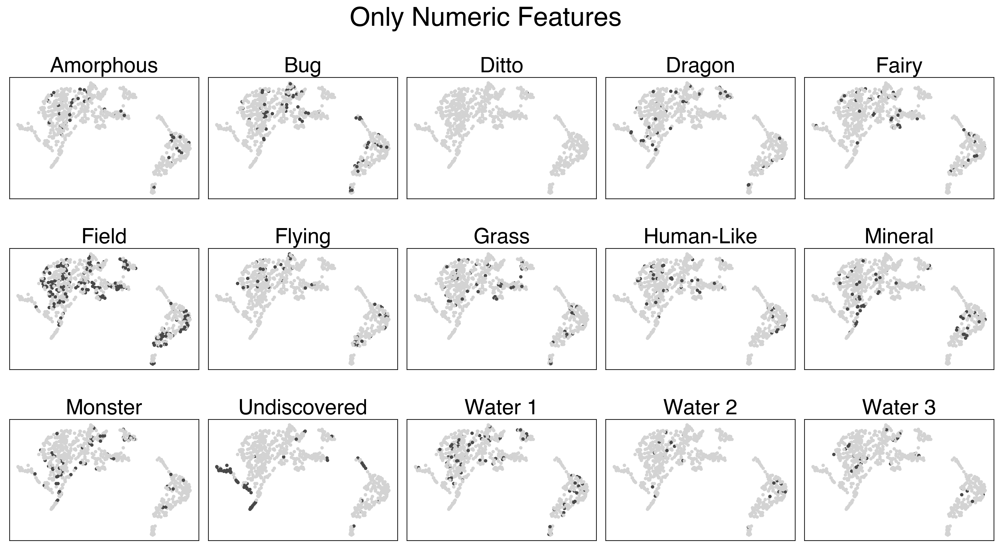

In [13]:
plot_egg_group_sns(embedding_only_num, "Only Numeric Features")

## Only Categorical Features

Next, I looked at the UMAP projection of the data using only the categorical features.

In [14]:
reducer_only_cat = umap.UMAP(metric="precomputed", min_dist=0.4, n_neighbors=8, random_state=42)
embedding_only_cat = reducer_only_cat.fit_transform(pokemon_dm_gower_cat)
plot_bokeh(
    embedding_only_cat, 
    "Only Categorical Features", 
    "pokemon_only_cat",
    "../html/pokemon_only_cat.html",
    size=5,
    line_color='black',
    line_width=0.5,
    color='blue',
)

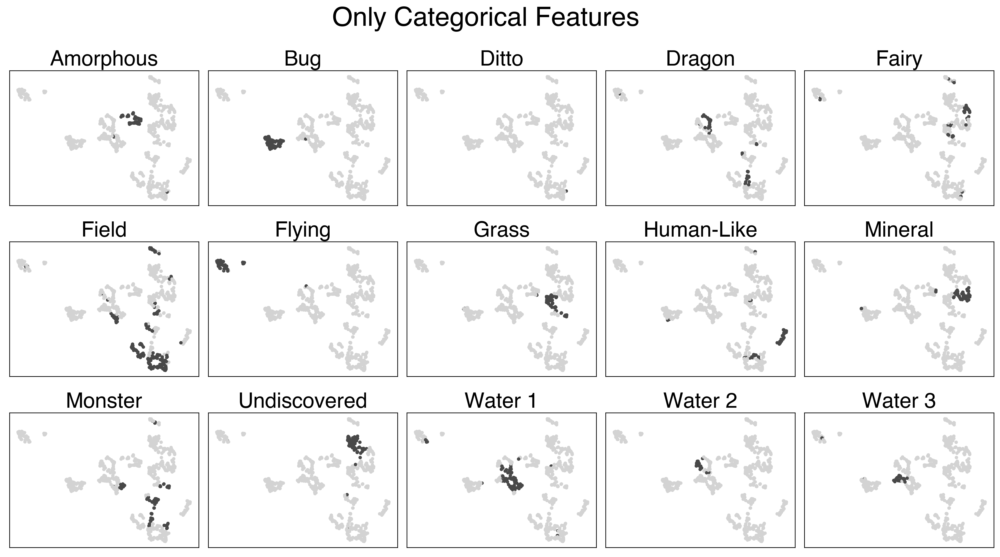

In [15]:
plot_egg_group_sns(embedding_only_cat, "Only Categorical Features")

## Both Numeric and Categorical Features

Finally, I incorporated both types of data.

In [16]:
reducer_gower = umap.UMAP(metric="precomputed", min_dist=0.4, n_neighbors=8, random_state=42)
embedding_gower = reducer_gower.fit_transform(pokemon_dm_gower)
plot_bokeh(
    embedding_gower, 
    "Both Numeric and Categorical Features", 
    "pokemon_gower",
    "../html/pokemon_gower.html",
    size=5,
    line_color='black',
    line_width=0.5,
    color='yellow',
)

## Plotting by Type

In [17]:
gower_umap_df = pd.DataFrame(embedding_gower).join(pokemon_df)
gower_umap_df.rename(columns={0: 'x', 1: 'y'}, inplace=True)
gower_umap_df.head()

,x,y,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,...,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style,img
0,-4.978108,-5.866829,Bulbasaur,Grass,Poison,318,45,49,49,65,...,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
1,-4.897075,-5.887284,Ivysaur,Grass,Poison,405,60,62,63,80,...,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
2,-4.817234,-5.744261,Venusaur,Grass,Poison,525,80,82,83,100,...,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
3,-3.864975,-4.339019,Charmander,Fire,Fire,309,39,52,43,60,...,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
4,-3.794139,-4.329369,Charmeleon,Fire,Fire,405,58,64,58,80,...,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."


In [18]:
all_types = gower_umap_df["Type_1"].unique()
type_dict = {
    "Fire": "#F08030", 
    "Grass": "#78C850", 
    "Water": "#6890F0", 
    "Bug": "#a8b820",
    "Normal": "#a8a878",
    "Poison": "#A040A0",
    "Electric": "#F8D030",
    "Ground": "#E0C068",
    "Dark": "#705848",
    "Psychic": "#F85888",
    "Dragon": "#7038F8",
    "Flying": "#A890F0",
    "Fairy": "#EE99AC",
    "Fighting": "#C03028",
    "Ghost": "#705898",
    "Rock": "#B8A038",
    "Steel": "#B8B8D0",
    "Ice": "#98D8D8",
}

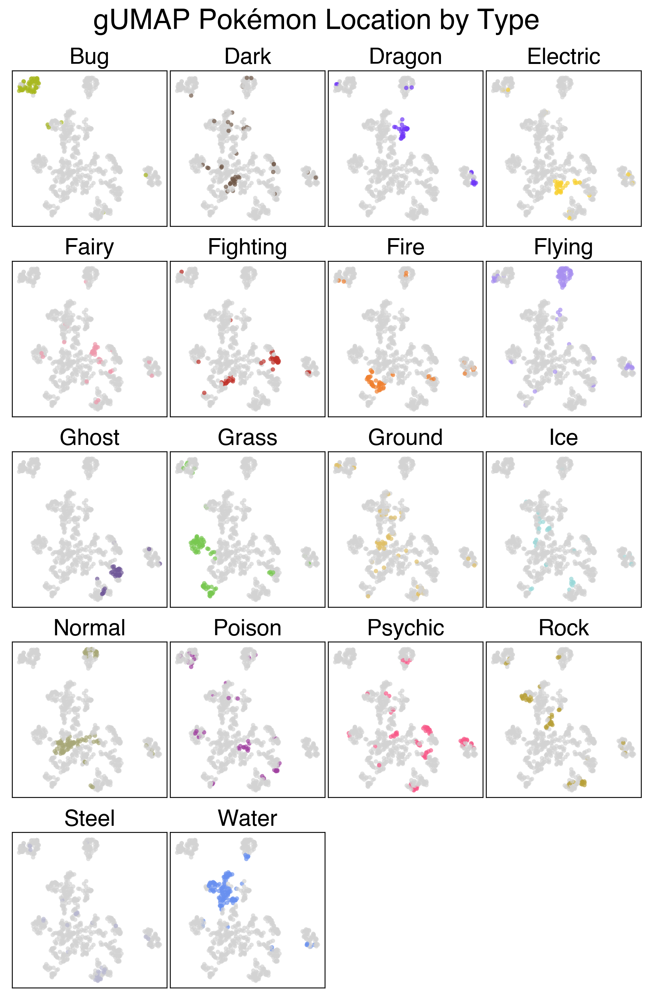

In [19]:
plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(5, 4, figsize=(10, 15), dpi=300, subplot_kw={'aspect': 'equal'})
plt.subplots_adjust(wspace=0.02, hspace=0.2)

for i, this_type in enumerate(sorted(all_types)):
    ax = axes.flat[i]
    df_copy = gower_umap_df.copy()
    color_vals = df_copy.apply(
        get_either_param, 
        1, 
        param1="Type_1",
        param2="Type_2",
        value=this_type,
    )
    df_copy["color"] = color_vals
    
    sns.scatterplot(
        data=df_copy,
        x="x",
        y="y",
        s=15,
        hue="color",
        palette={this_type: type_dict[this_type], "other": "#D3D3D3"},
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.7,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.set_title(this_type, fontsize=20)

plt.suptitle("gUMAP Pokémon Location by Type", fontsize=25, y=0.93)

i += 1
while i < 20:
    axes.flat[i].set_visible(False)
    i += 1

plt.savefig("../figures/gUMAP_pokemon_location_by_type.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Stats

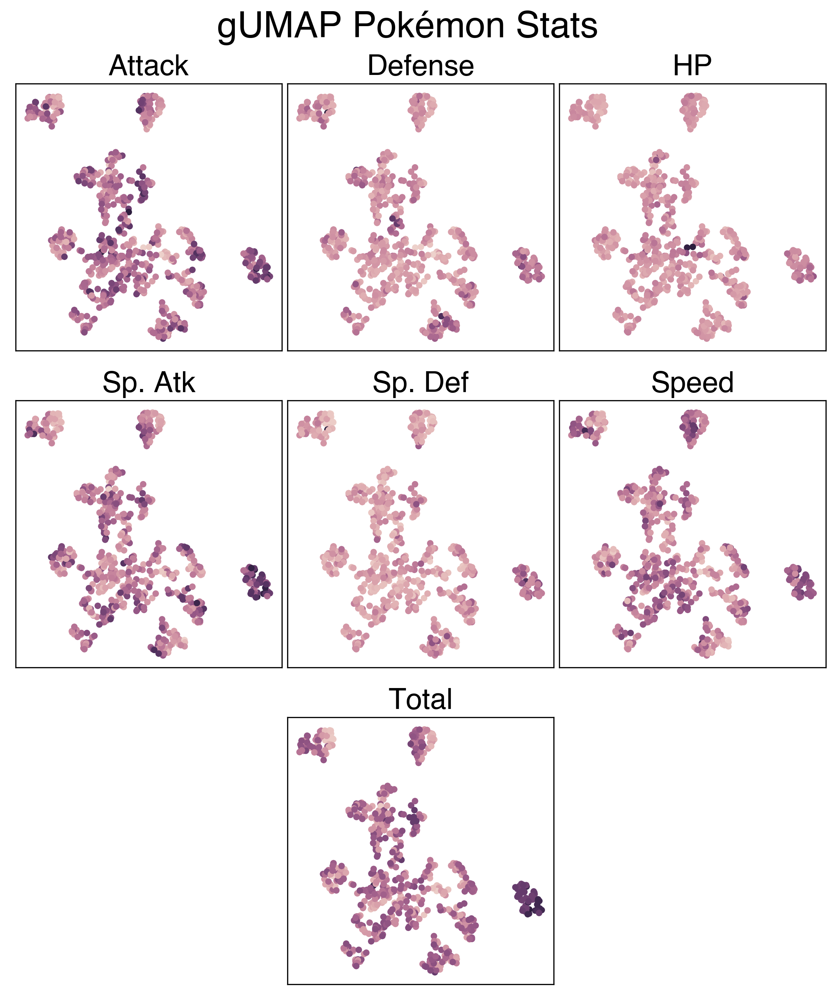

In [20]:
stats = ["Attack", "Defense", "HP", "Sp_Atk", "Sp_Def", "Speed", "Total"]
    
plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(3, 3, figsize=(10, 12), dpi=300, subplot_kw={'aspect': 'equal'})
plt.subplots_adjust(wspace=0.02, hspace=0.01)

for i in [0, 2]:
    axes[2, i].set_visible(False)

for i, this_stat in enumerate(stats):       
    if i == 6:
        ax = axes[2, 1]
    else:
        ax = axes.flat[i]
    
    sns.scatterplot(
        data=gower_umap_df,
        x="x",
        y="y",
        s=20,
        hue=this_stat,
        cmap=sns.cubehelix_palette(as_cmap=True),
        legend=False,
        edgecolor="black",
        linewidth=0,
        #alpha=0.7,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.set_title(this_stat.replace("_", ". "), fontsize=20)

plt.suptitle("gUMAP Pokémon Stats", fontsize=25, y=0.92)
plt.savefig("../figures/gUMAP_pokemon_stats.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Height and Weight

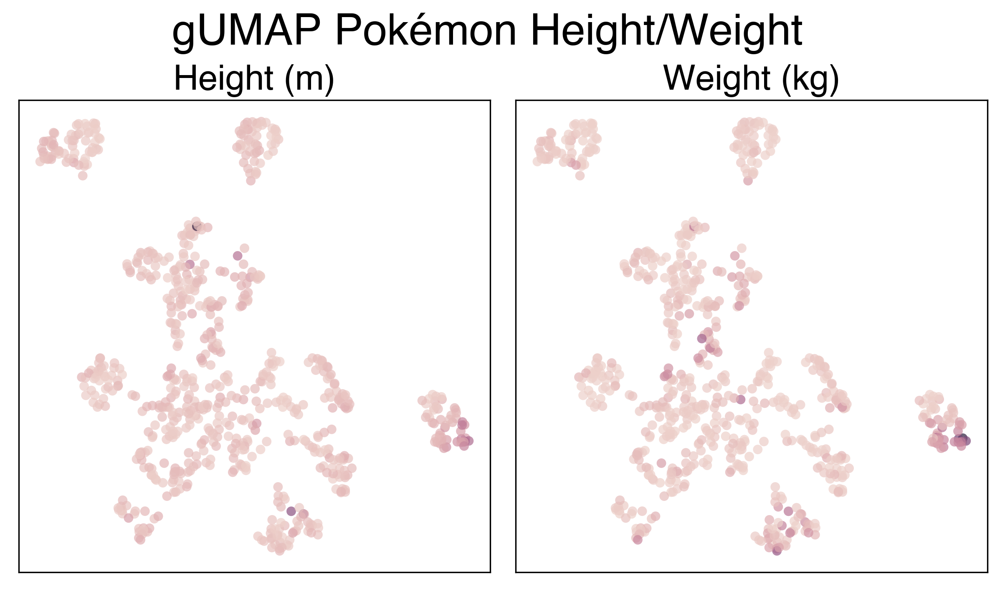

In [21]:
metrics = ["Height_m", "Weight_kg"]
    
plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(1, 2, figsize=(10, 5), dpi=300, subplot_kw={"aspect": "equal"})
plt.subplots_adjust(wspace=0.05, hspace=0.15)

for i, this_metric in enumerate(metrics):       
    ax = axes.flat[i]
    
    sns.scatterplot(
        data=gower_umap_df,
        x="x",
        y="y",
        s=30,
        hue=this_metric,
        cmap=sns.cubehelix_palette(as_cmap=True),
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.7,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    title = "{} ({})".format(*re.search("([A-Za-z]*)_([a-z]*)", this_metric).groups())
    ax.set_title(title, fontsize=20)

plt.suptitle("gUMAP Pokémon Height/Weight", fontsize=25, y=1.02)
plt.savefig("../figures/gUMAP_pokemon_height_weight.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Egg Group

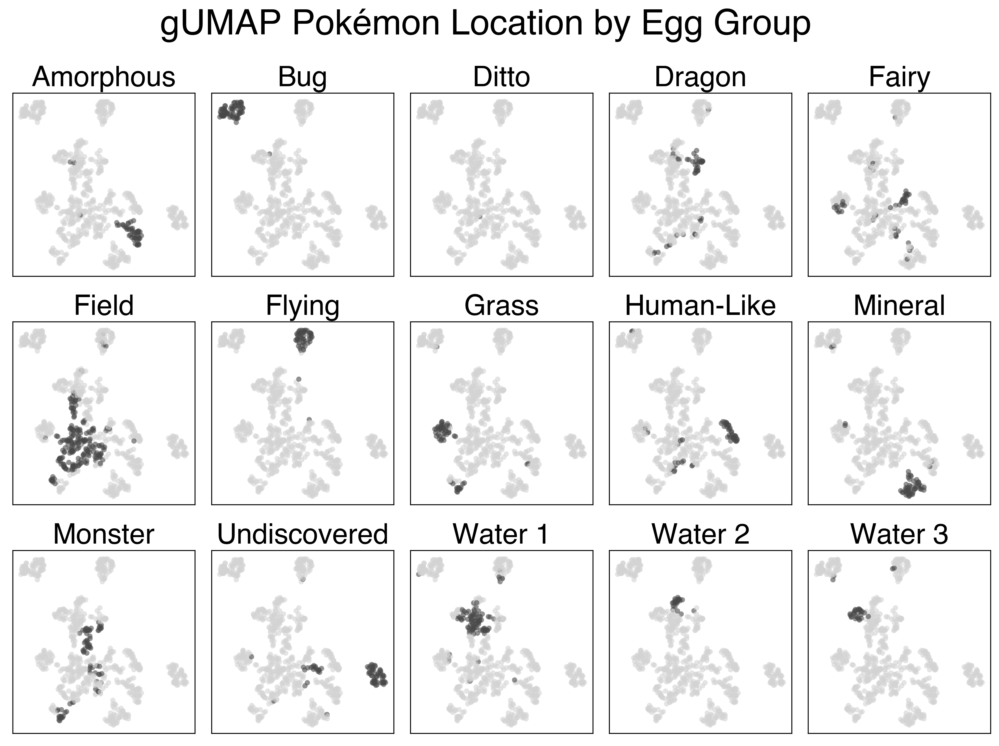

In [22]:
plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(3, 5, figsize=(15, 10), dpi=300, subplot_kw={"aspect": "equal"})
plt.subplots_adjust(wspace=0.05, hspace=0.25)

for i, this_egg_group in enumerate(all_egg_groups):       
    ax = axes.flat[i]
    df_copy = gower_umap_df.copy()
    df_copy["color"] = df_copy.apply(
        get_either_param,
        1,
        param1="Egg_Group_1",
        param2="Egg_Group_2",
        value=this_egg_group,
    )
    
    sns.scatterplot(
        data=df_copy,
        x="x",
        y="y",
        s=20,
        hue="color",
        palette={this_egg_group: "#484848", "other": "#D3D3D3"},
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.6,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.set_title(this_egg_group.replace("_", " "), fontsize=24)

plt.suptitle("gUMAP Pokémon Location by Egg Group", fontsize=30, y=0.98)
plt.savefig("../figures/gUMAP_pokemon_location_by_egg_group.png", dpi=300, bbox_inches="tight")
plt.show()

## Plotting by Body Style

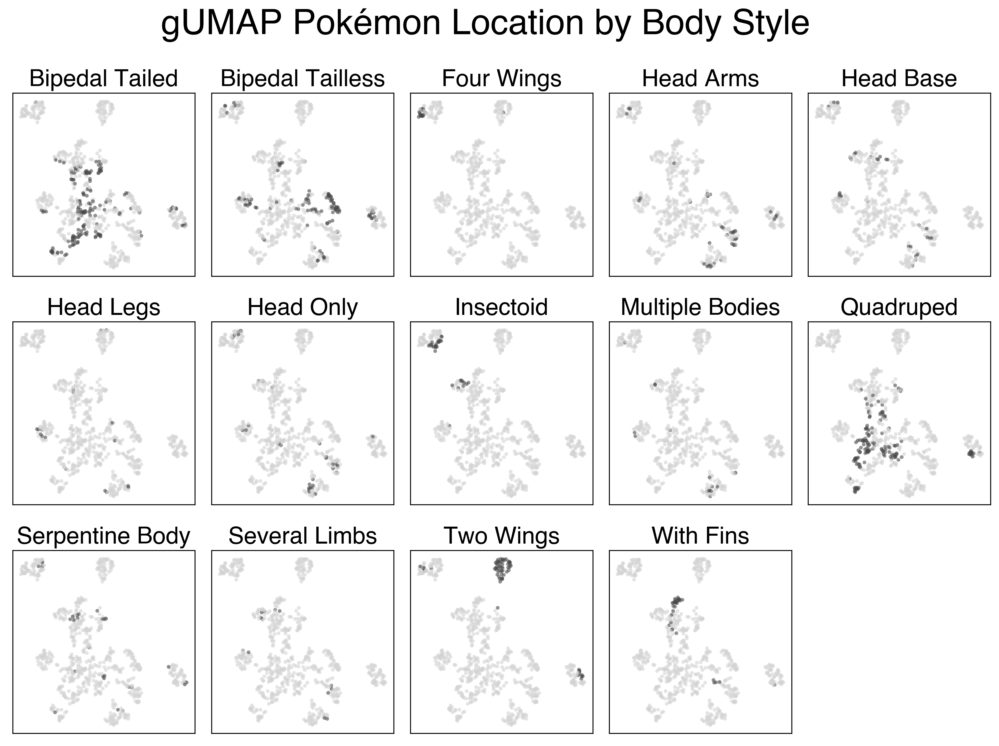

In [23]:
all_body_styles = gower_umap_df["Body_Style"].unique()

plt.rcParams["font.family"] = "Helvetica"
plt.rcParams["figure.facecolor"] = "white"
fig, axes = plt.subplots(3, 5, figsize=(15, 10), dpi=300, subplot_kw={"aspect": "equal"})
plt.subplots_adjust(wspace=0.05, hspace=0.25)

for i, this_body_style in enumerate(sorted(all_body_styles)):       
    ax = axes.flat[i]
    df_copy = gower_umap_df.copy()
    df_copy["color"] = df_copy.apply(
        lambda x: this_body_style if x["Body_Style"] == this_body_style else "other", 1
    )
    
    sns.scatterplot(
        data=df_copy,
        x="x",
        y="y",
        s=10,
        hue="color",
        palette={this_body_style: "#484848", "other": "#D3D3D3"},
        legend=False,
        edgecolor="black",
        linewidth=0,
        alpha=0.6,
        ax=ax,
    )
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    #title = "{} ({})".format(*re.search("([A-Za-z]*)_([a-z]*)", this_metric).groups())
    ax.set_title(this_body_style.replace("_", " ").title(), fontsize=20)

axes[-1][-1].set_visible(False)
plt.suptitle("gUMAP Pokémon Location by Body Style", fontsize=30, y=0.98)
plt.savefig("../figures/gUMAP_pokemon_location_by_body_style.png", dpi=300, bbox_inches="tight")
plt.show()

## One-Hot Encoding

In [24]:
pokemon_df.head()

,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,...,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style,img
0,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,...,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
1,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,...,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
2,Venusaur,Grass,Poison,525,80,82,83,100,100,80,...,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
3,Charmander,Fire,Fire,309,39,52,43,60,50,65,...,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."
4,Charmeleon,Fire,Fire,405,58,64,58,80,65,80,...,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed,"data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAA..."


In [25]:
cat_columns = ["Color", "Body_Style"]

In [26]:
encoding_df_list = list()
for col in cat_columns:
    col_encoded_df = pokemon_df[col].str.get_dummies()
    encoding_df_list.append(col_encoded_df)
type_encoding_df = pokemon_df["Type_1"].str.get_dummies() + pokemon_df["Type_2"].str.get_dummies()
type_encoding_df.columns += '_Type'
egg_group_encoding_df = pokemon_df["Egg_Group_1"].str.get_dummies() + pokemon_df["Egg_Group_2"].str.get_dummies()
egg_group_encoding_df.columns += '_EG'
encoding_df_list += [type_encoding_df, egg_group_encoding_df]
encoding_df = pd.concat(encoding_df_list, axis=1)
encoding_df = pokemon_df.join(encoding_df)
encoding_df.drop(
    [
        "Type_1", "Type_2", "Color", "Body_Style", "Egg_Group_1", "Egg_Group_2",
        "Name", "Pr_Male", "img", "Generation"
    ], 
    inplace=True, 
    axis=1
)

def str2bool(value: str) -> bool: return value == "True"

encoding_df["isLegendary"] = encoding_df["isLegendary"].apply(str2bool)
encoding_df["hasMegaEvolution"] = encoding_df["hasMegaEvolution"].apply(str2bool)
encoding_df["hasGender"] = encoding_df["hasGender"].apply(str2bool)
encoding_df = encoding_df.astype(int)

In [27]:
encoding_df.head()

,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,Speed,isLegendary,hasGender,hasMegaEvolution,...,Field_EG,Flying_EG,Grass_EG,Human-Like_EG,Mineral_EG,Monster_EG,Undiscovered_EG,Water_1_EG,Water_2_EG,Water_3_EG
0,318,45,49,49,65,65,45,0,1,0,...,0,0,1,0,0,1,0,0,0,0
1,405,60,62,63,80,80,60,0,1,0,...,0,0,1,0,0,1,0,0,0,0
2,525,80,82,83,100,100,80,0,1,1,...,0,0,1,0,0,1,0,0,0,0
3,309,39,52,43,60,50,65,0,1,0,...,0,0,0,0,0,1,0,0,0,0
4,405,58,64,58,80,65,80,0,1,0,...,0,0,0,0,0,1,0,0,0,0


In [28]:
reducer_encoding = umap.UMAP(min_dist=0.4, n_neighbors=8, random_state=42, metric="manhattan")
embedding_encoding = reducer_encoding.fit_transform(encoding_df)

In [29]:
plot_bokeh(
    embedding_encoding, 
    "One-Hot Encoding", 
    "pokemon_encoding",
    "../html/pokemon_encoding.html",
    size=5,
    line_color='black',
    line_width=0.5,
    color='green',
)

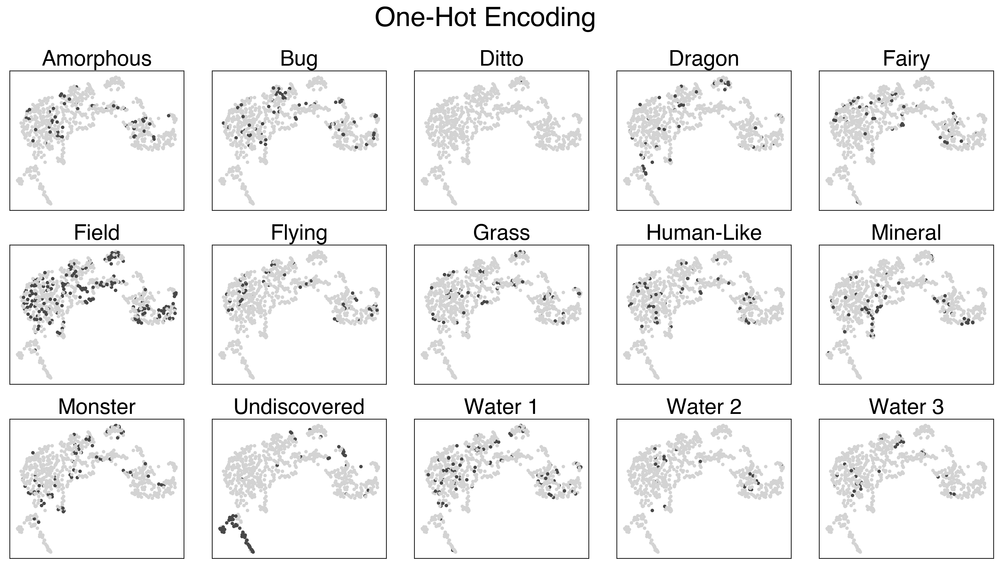

In [30]:
plot_egg_group_sns(embedding_encoding, "One-Hot Encoding")